# Chapter 1 Practice Problems

All examples are from 'Learning Computer Vision in Python' book by Jan Erik Solem

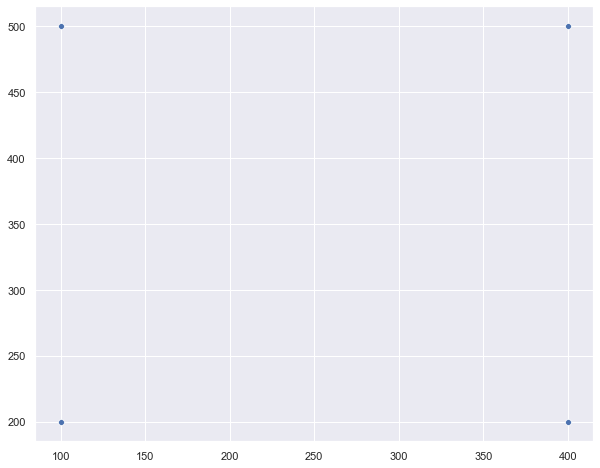

In [4]:
from matplotlib import pyplot as plt
from IPython.display import display
import numpy as np
import matplotlib
from PIL import Image
import time
from ipywidgets import interact, fixed
from im_tools import get_list_of_images
import seaborn as sns

%matplotlib inline
matplotlib.rcParams['figure.figsize'] = (10.0, 8.0)
sns.set()
# some points
x = [100,100,400,400]
y = [200,500,200,500]
# plot the points
sns.scatterplot(x,y)
plt.show()

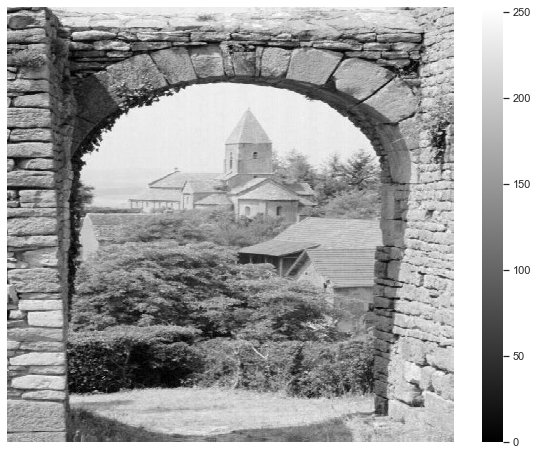

In [132]:
sns.heatmap(np.array(arch.convert('L')), cmap='gray')
plt.axis('off')
plt.show()

In [1]:
from PIL import Image
import time
from ipywidgets import interact, fixed
from im_tools import get_list_of_images

arch = Image.open('samples/ARCH.JPG')
# Show the PIL Image inline
# display(arch)

# Crop the arch
@interact
def crop(l=100,t=300,r=500,b=500):
    box = (l,t,r,b)
    region = arch.crop(box)
    display(region)

interactive(children=(IntSlider(value=100, description='l', max=300, min=-100), IntSlider(value=300, descripti…

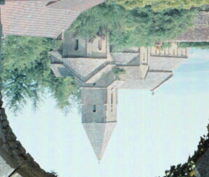

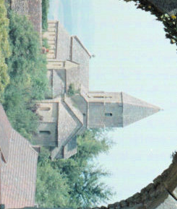

(177, 209)
(103, 69, 280, 278)


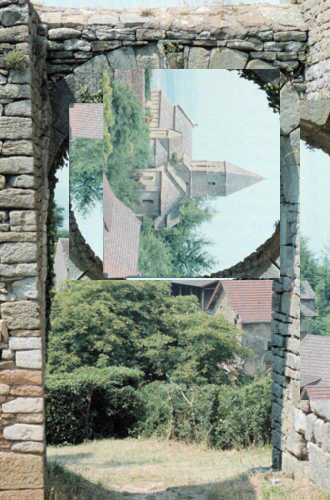

In [58]:
box = (69,103,278,280)
cropped = arch.crop(box)
display(cropped)

# Rotate the image
cropped = cropped.transpose(Image.ROTATE_90)
display(cropped)
print(cropped.size)
print((box[1], box[0], box[3], box[2]))
arch.paste(cropped,(box[1], box[0], box[3], box[2]))
display(arch)

(691, 457)


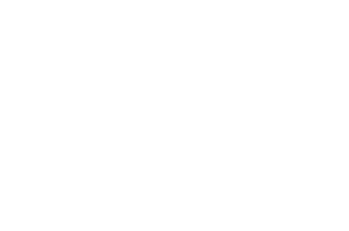

interactive(children=(IntSlider(value=150, description='levels', max=450, min=-150), Output()), _dom_classes=(…

In [110]:
# Convert to grayscale
im = Image.open('samples/arch.jpg')
# display(im)
im = im.convert('L')
im_arr = np.array(im)
print(im_arr.shape)
# Plotting
plt.axis('equal')
plt.axis('off')
@interact
def ctr(levels = 150):
    global fig
    global ax
    plt.imshow(im_arr, cmap='gray')
    plt.contour(im_arr, [levels], origin='image')
# plt.show()

In [182]:
np.random.rand(10)

array([0.4132327 , 0.58189648, 0.76756963, 0.65822261, 0.74228079,
       0.94325081, 0.38903663, 0.46444054, 0.84860649, 0.85830534])

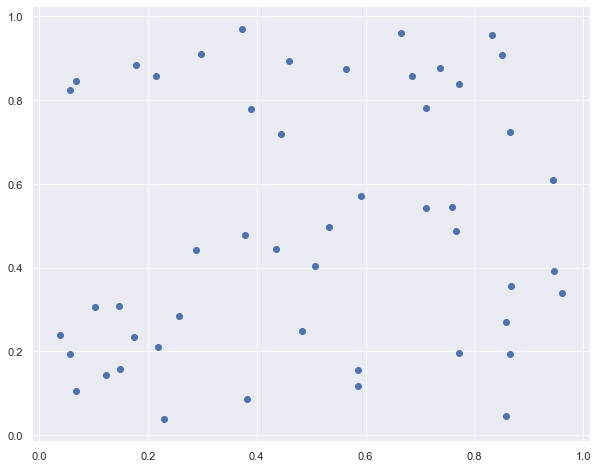

In [190]:
e

In [2]:
from PIL import Image
import numpy as np
# Grayscale modifications
im = Image.open('computer_vis_course/samples/Road.jpg').convert('L')
# display(im)

im_arr = np.array(im).astype(np.float16)
im_arr2 = 255-im_arr # Invert the image
im_arr3 = (20/255)*im_arr + 20 # conver the image to 0-100 range
im_arr4 = 255.0 * (im_arr/255.0)**3 #squared

# for i in [im_arr, im_arr2, im_arr3, im_arr4]:
#     display(Image.fromarray(i.astype('uint8')))

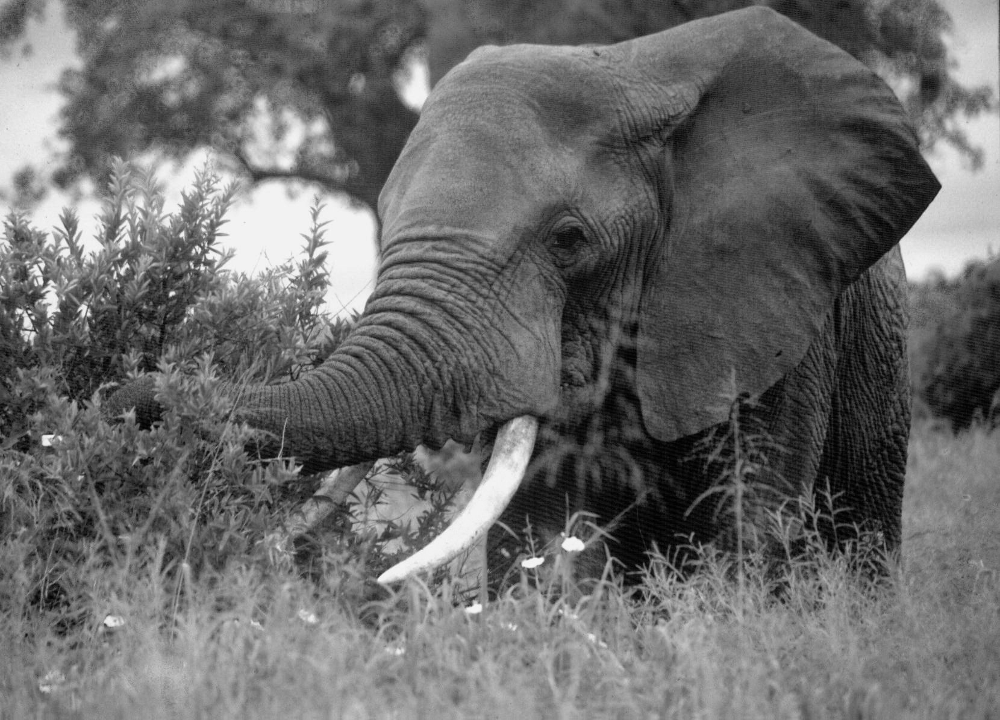

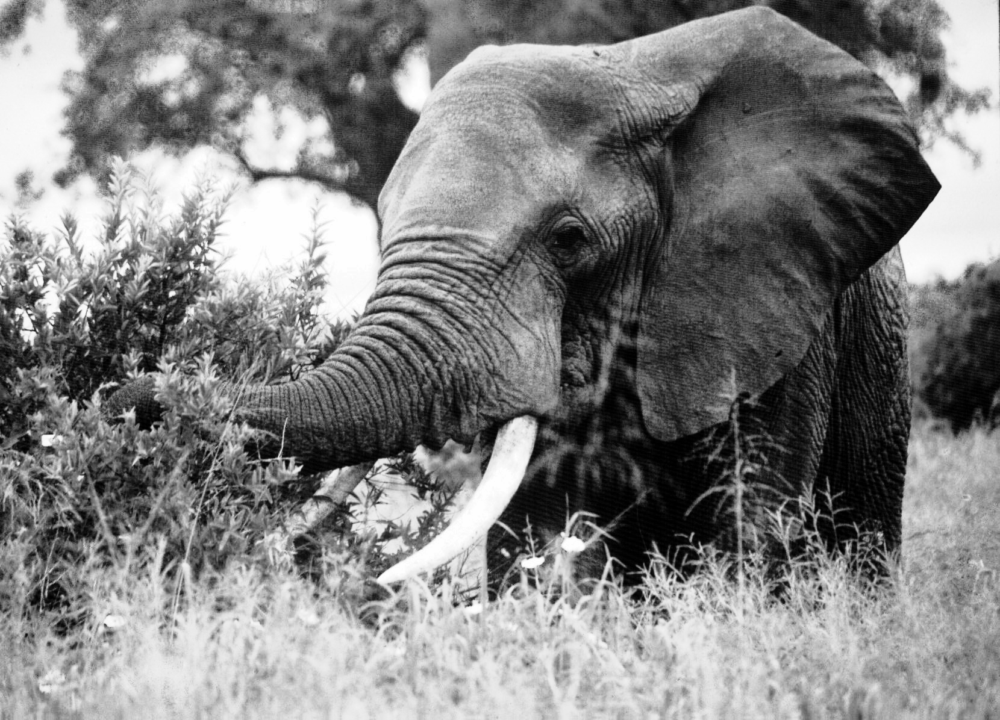

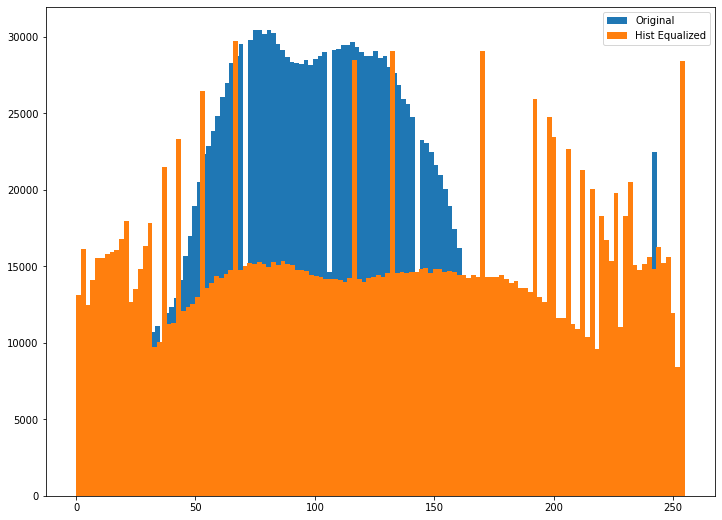

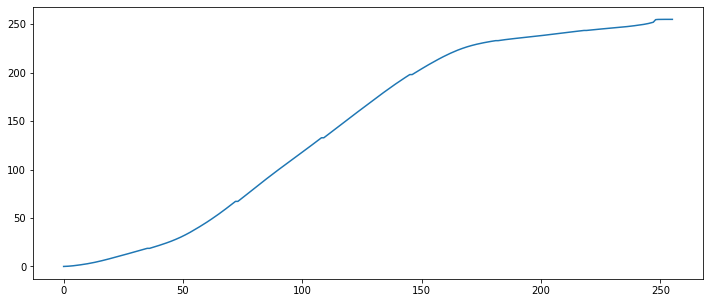

In [15]:
# histogram equalization of grayscale image
import matplotlib
matplotlib.rcParams['figure.figsize'] = (20.0, 8.0)
%matplotlib inline
from computer_vis_course.im_tools import histeq
from matplotlib import pyplot as plt

im = Image.open('computer_vis_course/samples/Elephant Close.jpg').convert('L')

display(im)
plt.figure()
plt.gcf().set_size_inches(12,9)
hist_im, cdf = histeq(np.array(im))
display(Image.fromarray(hist_im.astype('uint8')))
plt.hist(np.array(im).flatten(), 128, label='Original')
plt.hist(np.array(hist_im).flatten(), 128, label='Hist Equalized')
plt.legend()
plt.show()
# plot the cdf
plt.plot(range(256), cdf)
plt.gcf().set_size_inches(12,5)
plt.show()

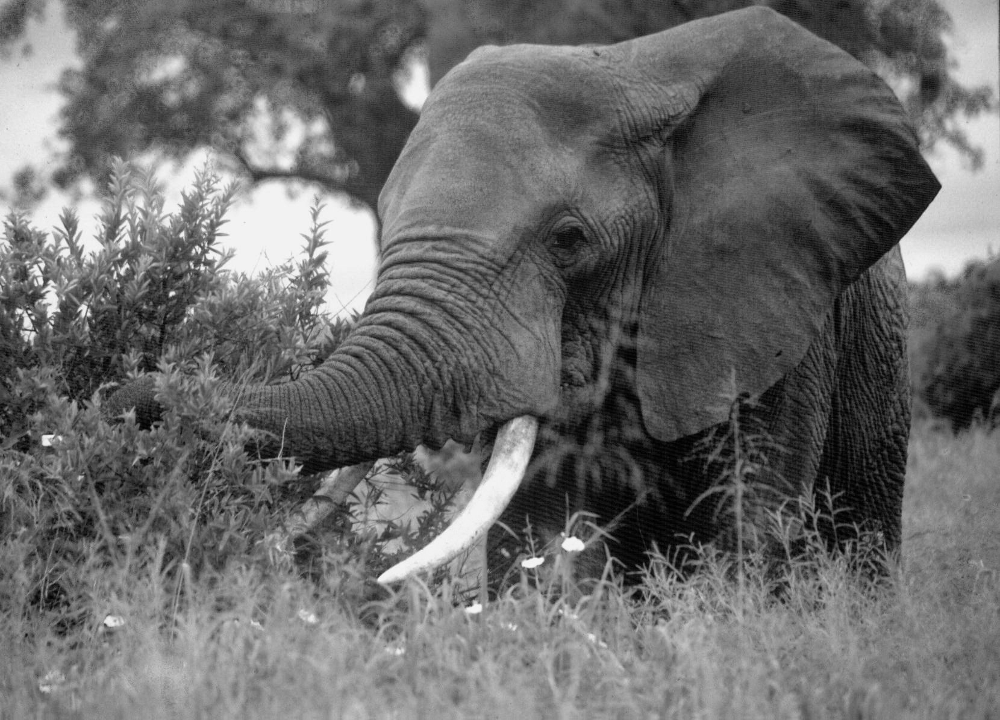

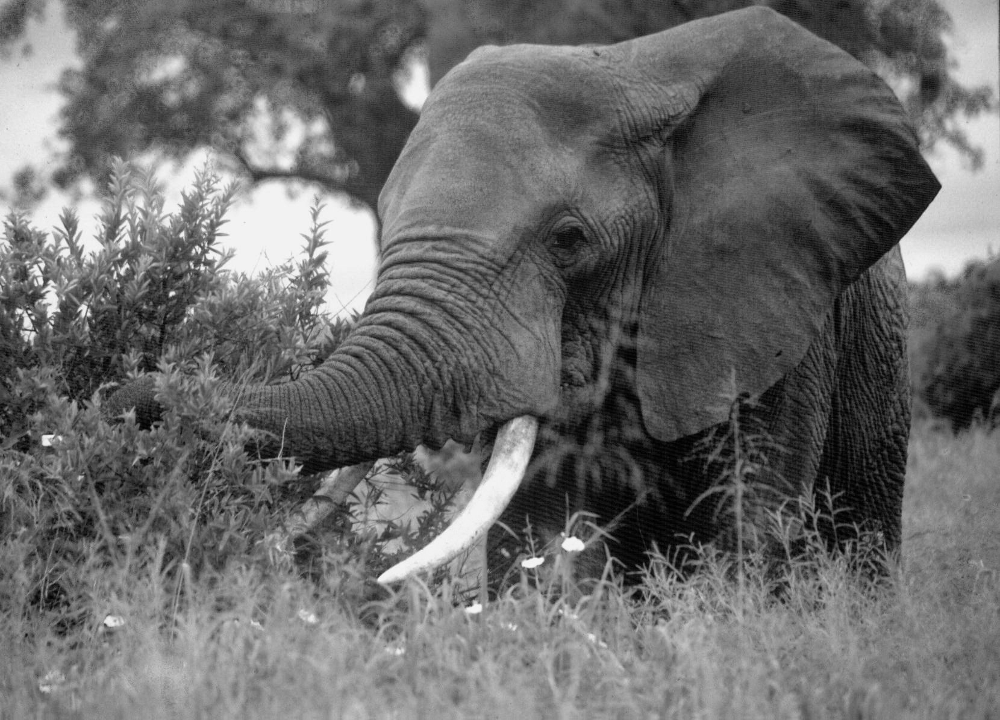

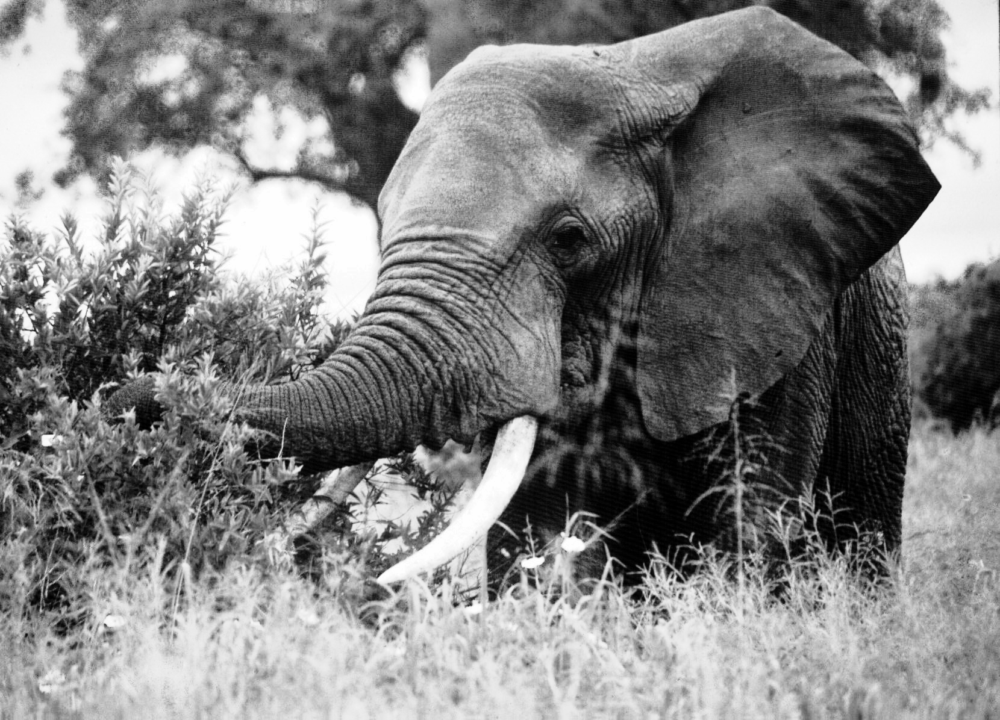

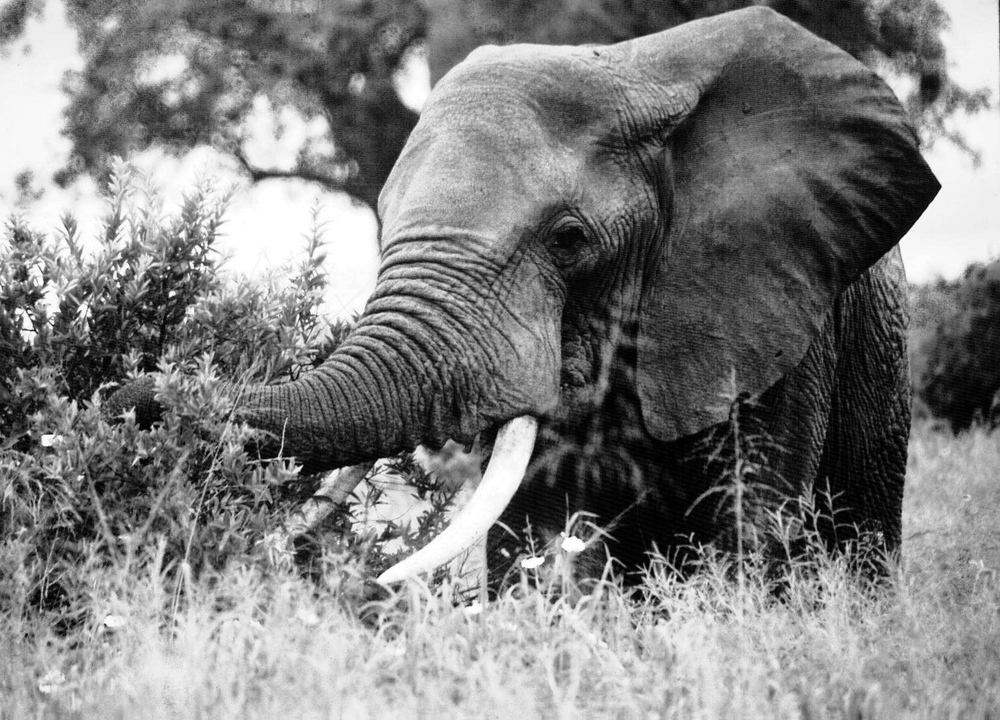

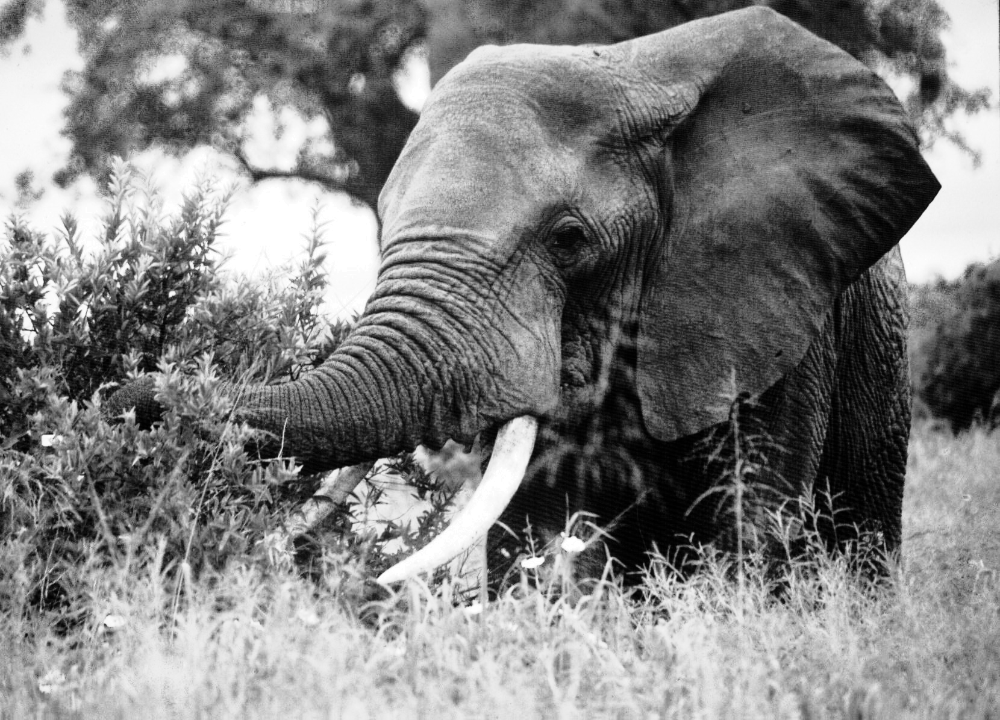

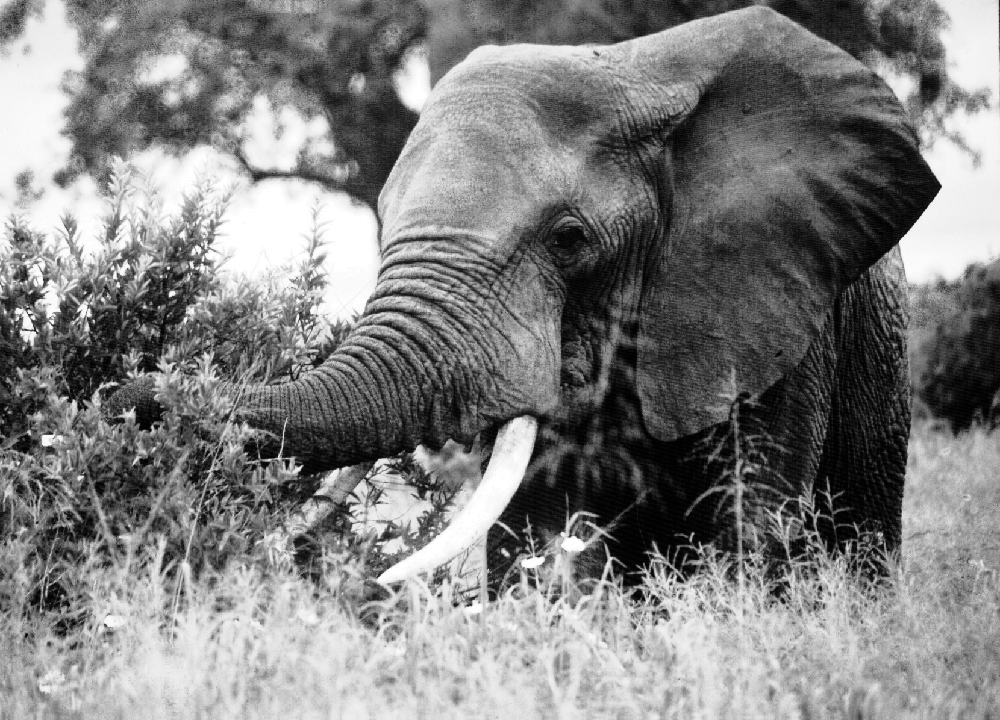

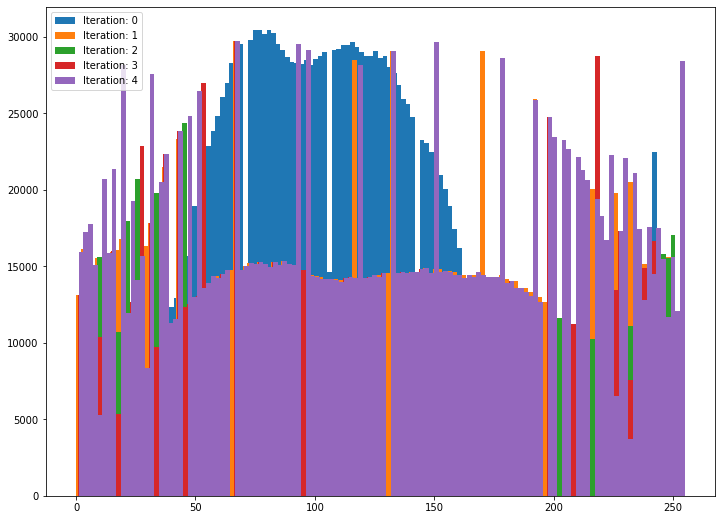

In [22]:
# Histogram Equalization
# What about repeated applications of hist_eq?
plt.figure()
plt.gcf().set_size_inches(12,9)
im = Image.open('computer_vis_course/samples/Elephant Close.jpg').convert('L')
display(im)
im = np.array(im)
for i in range(5):
    plt.hist(np.array(im).flatten(), 128, label='Iteration: {}'.format(i))
    display(Image.fromarray(im.astype('uint8')))
    im, _ = histeq(np.array(im))
plt.legend()
plt.show()
    

In [32]:
x = ['foo', [1,2,3], 10.4]
y = list(x) # or x[:]
y[0] = 'fooooooo'
y[1][0] = 4
print(x)
print(y)

['foo', [4, 2, 3], 10.4]
['fooooooo', [4, 2, 3], 10.4]


In [143]:
#PCA for machine learning inputs
# See examples here as well: https://towardsdatascience.com/pca-using-python-scikit-learn-e653f8989e60
from sklearn.datasets import fetch_openml
mnist = fetch_openml('mnist_784', version=1, cache=True)

In [39]:
from sklearn.model_selection import train_test_split
# test_size: what proportion of original data is used for test set
train_img, test_img, train_lbl, test_lbl = train_test_split( mnist.data, mnist.target, test_size=0.00001, random_state=0)

from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()

scaler.fit(train_img)

StandardScaler(copy=True, with_mean=True, with_std=True)

In [54]:
# # Apply transform to both the training set and the test set.
# https://github.com/mGalarnyk/Python_Tutorials/blob/master/Sklearn/PCA/PCA_Image_Reconstruction_and_such.ipynb
mnist_scaled = scaler.transform(train_img)

from sklearn.decomposition import PCA
# Make an instance of the Model
pca = PCA(.5)
pca.fit(mnist.data)

lower_dimensional_data = pca.fit_transform(mnist.data)
print(pca.n_components_)

11


In [59]:
lower_dimensional_data.shape

(70000, 11)

In [58]:
# Great, lets reconstruct our images now
approximation = pca.inverse_transform(lower_dimensional_data)
# help(approximation)
from ipywidgets import interact
@interact
def plot(i=100):
    plt.figure(figsize=(8,4));
    # Original Image
    plt.subplot(1, 2, 1);
    plt.imshow(mnist.data[i].reshape(28,28),
                  cmap = plt.cm.gray, interpolation='nearest',
                  clim=(0, 255));
    plt.xlabel('784 components', fontsize = 14)
    plt.title('Original Image', fontsize = 20);

    # 154 principal components
    plt.subplot(1, 2, 2);
    plt.imshow(approximation[i].reshape(28, 28),
                  cmap = plt.cm.gray, interpolation='nearest',
                  clim=(0, 255));
    plt.xlabel('{} components'.format(pca.n_components_), fontsize = 14)
    plt.title('95% of Explained Variance', fontsize = 20);
plt.show()

interactive(children=(IntSlider(value=100, description='i', max=300, min=-100), Output()), _dom_classes=('widg…

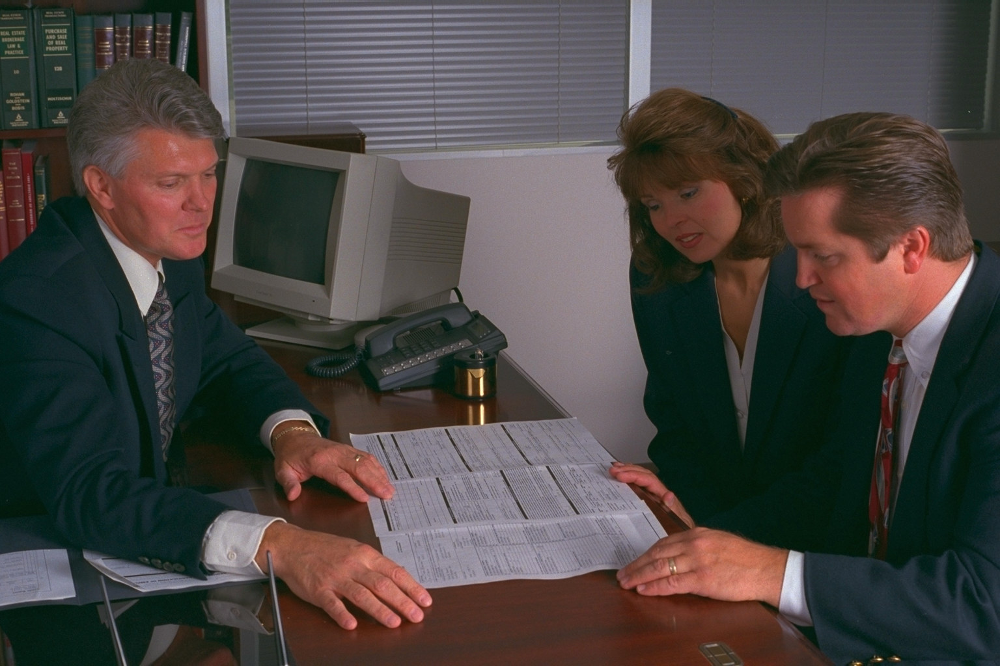

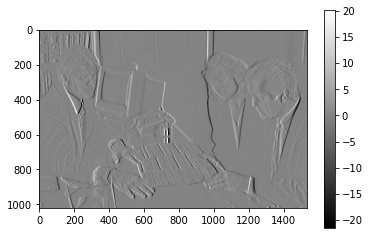

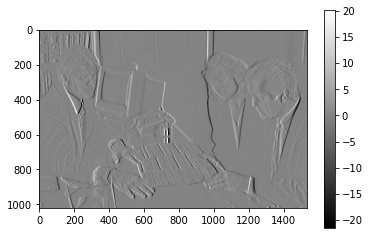

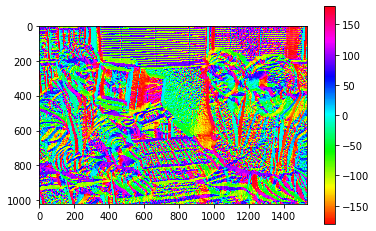

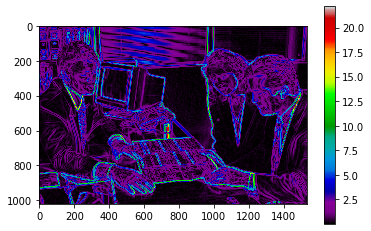

In [100]:
# Image derivatives using gaussian derivative filters
from scipy.ndimage import filters, gaussian_filter
im_name = 'meeting'
im = np.array(Image.open('computer_vis_course/samples/{}.jpg'.format(im_name)).convert('L'))
display(Image.open('computer_vis_course/samples/{}.jpg'.format(im_name)))
# display(im)
# Compute the image derivatives using Gaussian derivative 
sigma = 3 #standard deviation
imx,imy = np.zeros(im.shape), np.zeros(im.shape)
tempx =filters.gaussian_filter(im, (sigma,sigma), (0,1), imx)
tempy = filters.gaussian_filter(im, (sigma,sigma), (1,0), imy)

plt.imshow(tempx, cmap = 'gray')
plt.colorbar()
plt.show()

plt.imshow(imx, cmap = 'gray')
plt.colorbar()
plt.show()

plt.imshow(180/np.pi * np.arctan2(imy,imx), cmap = 'hsv')
plt.colorbar()
plt.show()
plt.imshow(np.sqrt(imy**2+imx**2), cmap = 'nipy_spectral')
plt.colorbar()
plt.show()

### Neat, I like the image derivative filters

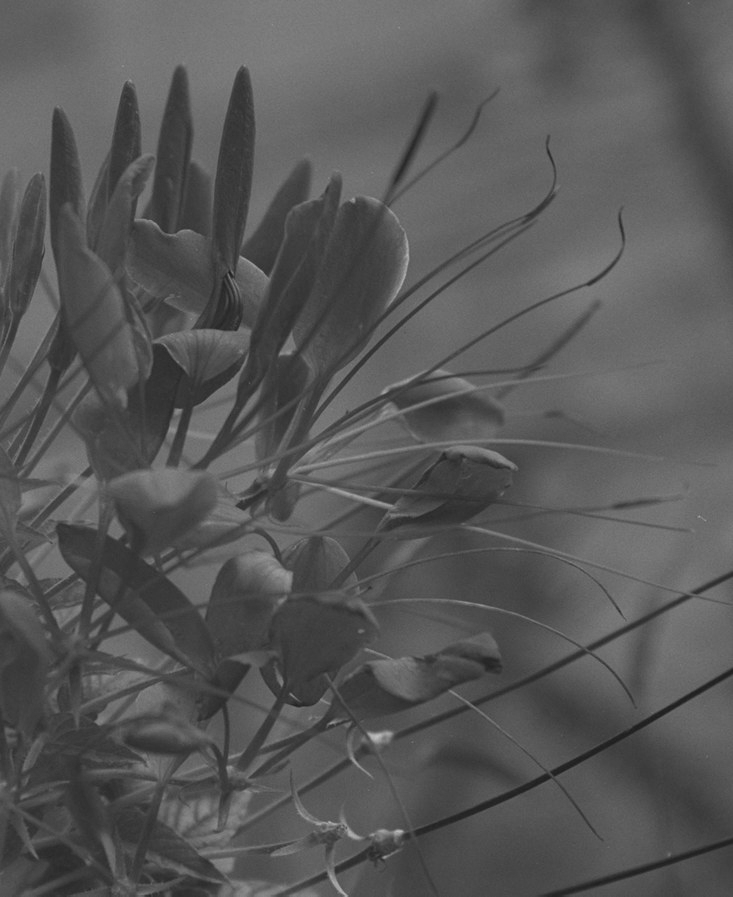

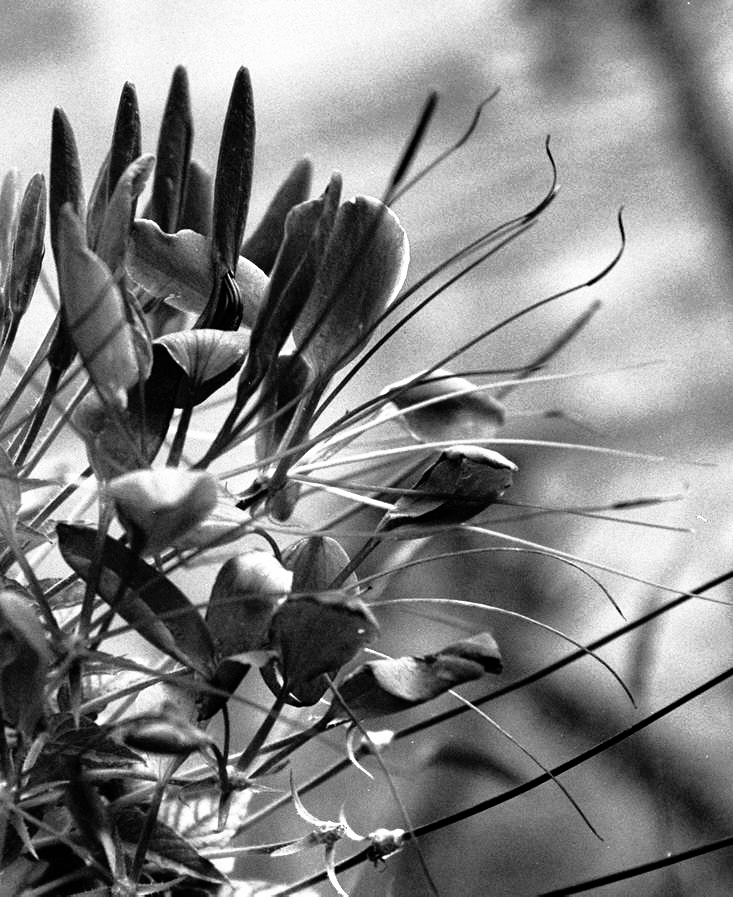

max:255.0, min:0.00038783210976104954
max:True, min:False
[[False False False ... False False False]
 [False False False ... False False False]
 [False False False ... False False False]
 ...
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]
 [ True  True  True ...  True  True  True]]
(897, 733)


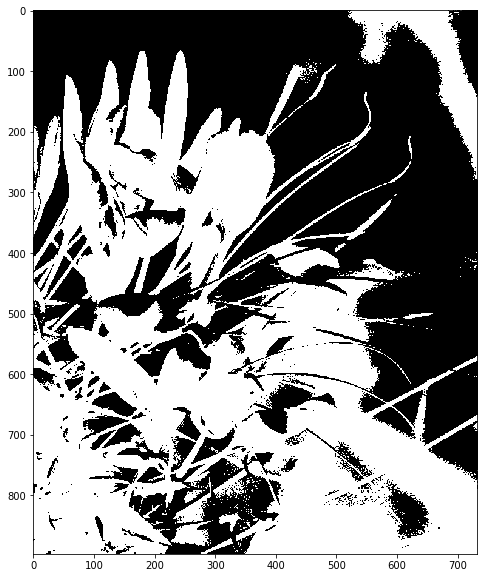

In [129]:
# Morphology and Measurement - Counting Objects
im = Image.open('computer_vis_course/samples/PRPLFLWR.jpg').convert('L')
display(im)
im = np.array(im)
from computer_vis_course.im_tools import histeq
im, _ = histeq(im, )
display(Image.fromarray(im.astype('uint8')))
print('max:{}, min:{}'.format(np.max(im), np.min(im)))

im = (im<128)
print('max:{}, min:{}'.format(np.max(im), np.min(im)))
print(im)
print(im.shape)
plt.gcf().set_size_inches(10,10)
plt.imshow(im, cmap='gray', vmin=0, vmax=1)

# Now we have our binary image im

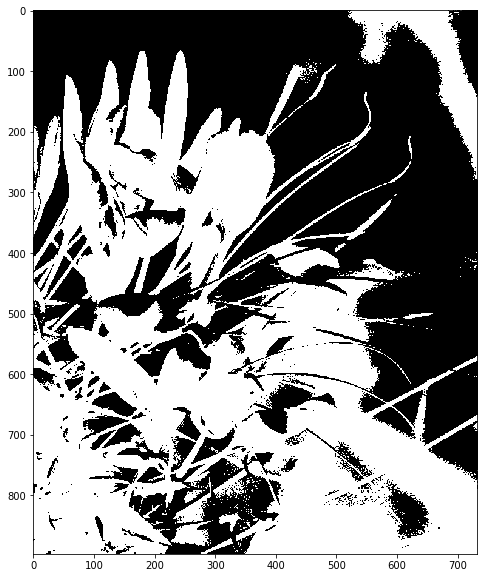

interactive(children=(IntSlider(value=5, description='it', max=15, min=-5), Output()), _dom_classes=('widget-i…

In [142]:
# Take im and perform binary_opening to open up gaps between objects
from scipy.ndimage import morphology, measurements
plt.figure().set_size_inches(10,10)
plt.imshow(im, cmap='gray', vmin=0, vmax=1)
plt.show()
@interact
def print_iterated_opened(it=5):
#     plt.figure().set_size_inches(10,10)
    im_open = morphology.binary_opening(im,np.ones((5,5)), it)
    print(im_open.shape)
#     plt.imshow(im_open, cmap='gray', vmin=0, vmax=1)
#     plt.show()
    labels, n = measurements.label(im_open)
    print('\n\n Number of objects: {}\n\n'.format(n))
    plt.figure().set_size_inches(10,10)
    plt.imshow(labels)
    plt.show()
plt.show()

There was some morphology combined with measurement. <div text-color="blue">Neato!</div>


Number of objects: 13


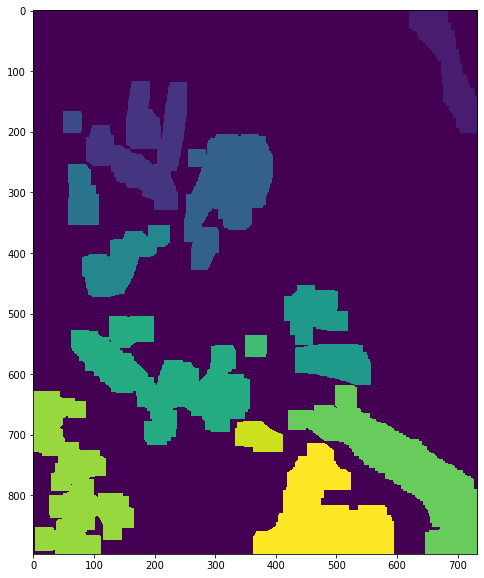

In [135]:
im_open = morphology.binary_opening(im,np.ones((5,5)), iterations=7)
labels, n = measurements.label(im_open)
print('Number of objects: {}'.format(n))
plt.figure().set_size_inches(10,10)
plt.imshow(labels)
plt.show()

## Denoising 

Lets practice with the grassland1 photo

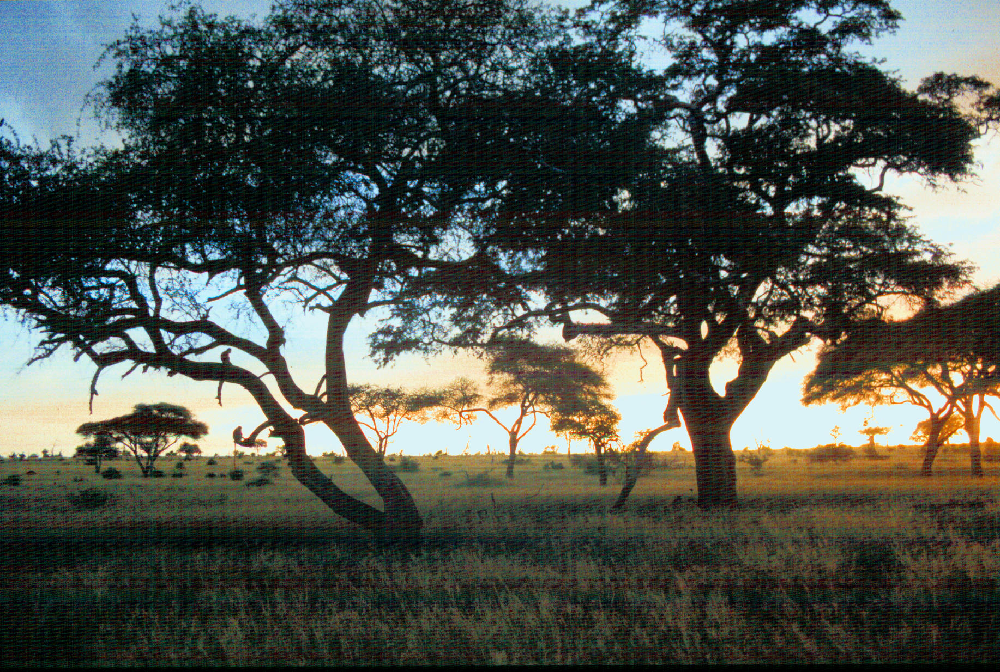

In [156]:

im = Image.open('computer_vis_course/samples/grassland1.jpg')
display(im)

In [3]:
import os
# os.chdir('computer_vis_course')
from PIL import Image
from denoise import denoise
import numpy as np

im = Image.open('samples/grassland1.jpg')
# display(im)
# 
arr_im = np.array(im.convert('L'))
soln = denoise(arr_im)

KeyboardInterrupt: 

In [ ]:
soln.x

In [157]:

cropped = arch.crop((104,145,366,385))
# Convert the arch to a thumbnail
arch.thumbnail((500,500))
display(arch)
imgs = get_list_of_images('samples')
# for i in imgs:
#     display(Image.open(i))
#     time.sleep(1)

NameError: name 'arch' is not defined